In [1]:
import torch
from torch import nn
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import Dataset, DataLoader, random_split, SubsetRandomSampler
from torchvision import models
import albumentations as A
from albumentations.pytorch import ToTensorV2
from PIL import Image
import numpy as np
import logging
from addict import Dict
import os
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from datetime import datetime
import random
from urllib.request import urlretrieve
import shutil
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import cv2
from collections import Counter
from sklearn.model_selection import StratifiedShuffleSplit

LABEL_STUDIO_API_KEY not set
C:\Users\JCHAN087\PycharmProjects\pythonProject3\.venv\Lib\site-packages\google\auth\_default.py:76: UserWarning: Your application has authenticated using end user credentials from Google Cloud SDK without a quota project. You might receive a "quota exceeded" or "API not enabled" error. See the following page for troubleshooting: https://cloud.google.com/docs/authentication/adc-troubleshooting/user-creds. 
  warnings.warn(_CLOUD_SDK_CREDENTIALS_WARNING)
Could not connect to Label Studio at http://localhost:8080. LABEL_STUDIO_CLIENT will be None.


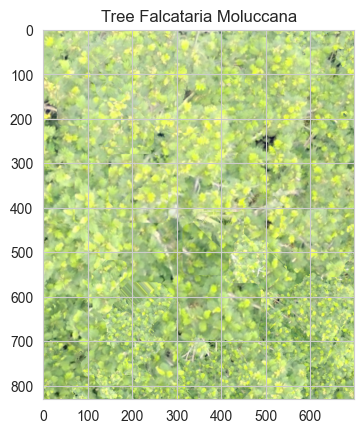

In [2]:
from frdc.load.preset import FRDCDatasetPreset
from frdc.preprocess.extract_segments import extract_segments_from_bounds
from frdc.preprocess.scale import scale_0_1_per_band

ds = FRDCDatasetPreset.chestnut_20201218()
ar, order = ds.get_ar_bands()
bounds, labels = ds.get_bounds_and_labels()
segments = extract_segments_from_bounds(ar, bounds)
segment_0_bgr = segments[0]
segment_0_rgb = segment_0_bgr[..., [2, 1, 0]]
segment_0_rgb_scaled = scale_0_1_per_band(segment_0_rgb)

plt.imshow(segment_0_rgb_scaled)
plt.title(f"Tree {labels[0]}")
plt.show()

# Load and Save Tree Data

In [11]:
from frdc.load.gcs import list_gcs_datasets
print(list_gcs_datasets())

0                                              DEBUG/0
1                            casuarina/20220418/183deg
2                             casuarina/20220418/93deg
3                        chestnut_nature_park/20201218
4    chestnut_nature_park/20210510/90deg43m85pct255deg
5    chestnut_nature_park/20210510/90deg60m84.5pct2...
Name: dataset_dir, dtype: object


In [209]:
ds_chestnut = FRDCDatasetPreset.chestnut_20201218()

In [178]:
ds_chestnut43 = FRDCDatasetPreset.chestnut_20210510_43m()

In [210]:
print(len(ds_chestnut))

33


In [211]:
from math import ceil
def plot_samples(samples: list[tuple[np.ndarray, str]],
                 title: str,
                 rows: int, ):
    """Plot a grid of samples with their targets."""
    fig, axs = plt.subplots(rows, ceil(len(samples) / rows),
                            figsize=(10, rows * 2))
    for (im_bgr, tgt), ax in zip(samples, axs.flatten()):
        im_rgb = np.nan_to_num(im_bgr[..., [2, 1, 0]]).astype(int)
        ax.imshow(im_rgb)
        ax.set_title(f"{tgt}")
        ax.axis("off")
        if im_rgb.max() > 1:
            im_rgb = im_rgb.astype(np.uint8)
         # Create folder for each target if it doesn't exist
        base_folder = "C:/Users/JCHAN087/Documents/chestnut/"
        target_folder = os.path.join(base_folder, tgt)
        os.makedirs(target_folder, exist_ok=True)

        # Save the image
        image_path = os.path.join(target_folder, f"{tgt}_{np.random.randint(10000)}.png")
        plt.imsave(image_path, im_rgb)
    fig.suptitle(title)
    fig.tight_layout()
    plt.show()

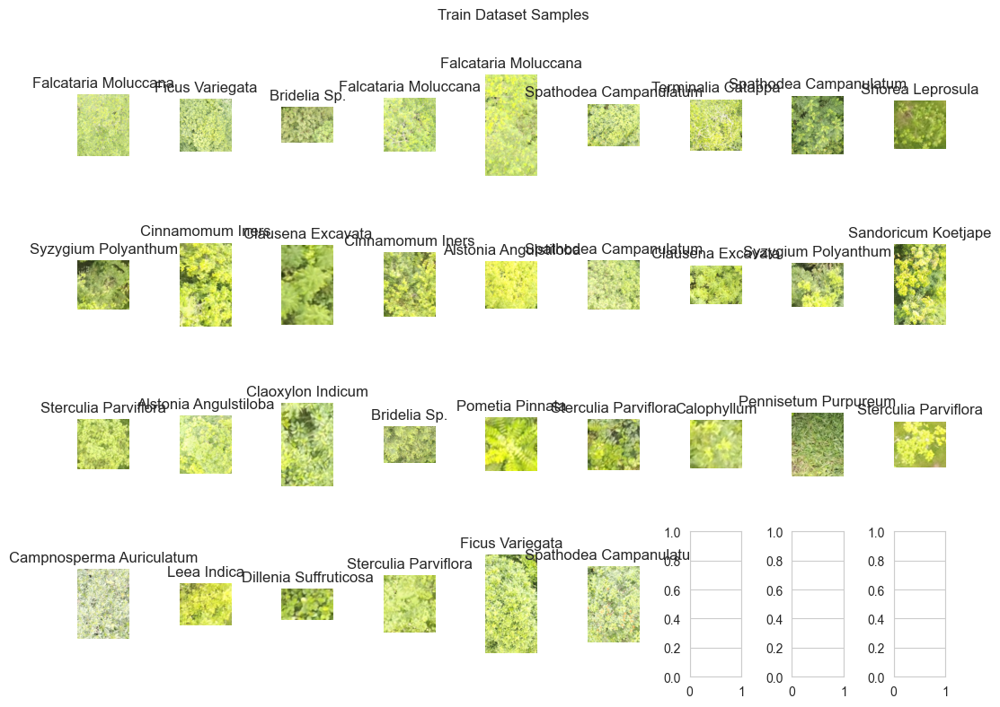

In [212]:
n_samples = 34
plot_samples(
    [(im, tgt) for _, (im, tgt) in
     zip(range(n_samples), ds_chestnut)],
    "Train Dataset Samples",
    rows=4,
)

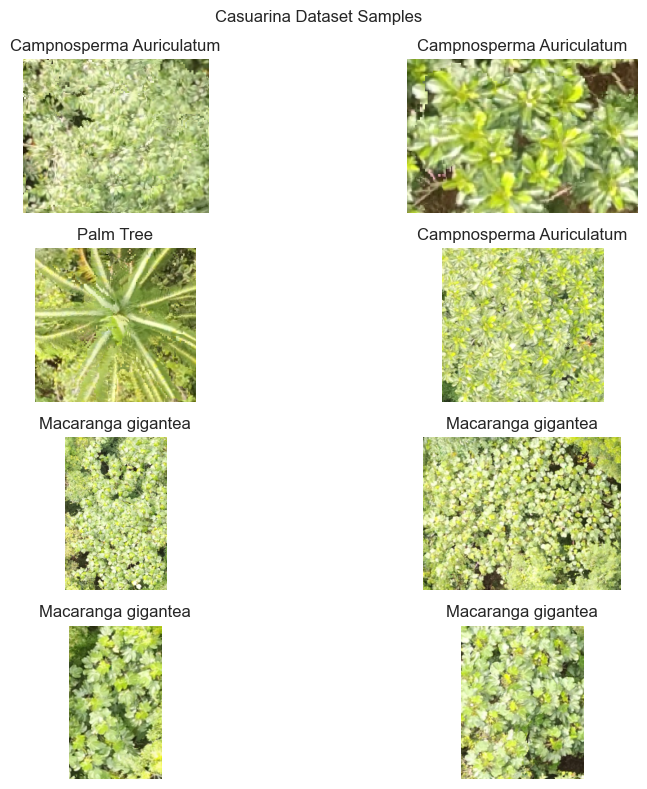

In [20]:
n_samples = 8
plot_samples(
    [(im, tgt) for _, (im, tgt) in
     zip(range(n_samples), ds_casuarina)],
    "Casuarina Dataset Samples",
    rows=4,
)

# Load dataset + albumentations

In [59]:
config = Dict({
    "path": "C:/Users/JCHAN087/Documents/train",
    "device": torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    "batch_size": 4,
    "augmentations": A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.3),
        A.Rotate(limit=60, p=0.7),
        A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=(0,0.2), p=0.5),
        A.RandomResizedCrop(height=256, width=256, scale=(0.8, 1.0), p=0.3),
        ToTensorV2(),
    ]),
    "num_workers": 0,
})

In [29]:
class AugDataset(Dataset):
    def __init__(self, path:str, shape=(256, 256), augmentations=None):
        self.__images_classes_paths = []
        self.__shape = shape                                                      #crops all images into a defined shape (i.e. 256x256 square)
        self.__augmentations = augmentations                                      #defines the augmentations being used during training, given in config parameter
        self.labels = []                                                          #dataset for each different type of flowers in the 
        print("Reduce dataset by x times:" )
        factor = input()   

        if os.path.exists(path):
            self.__path = path
            folders = [_ for _ in os.listdir(self.__path) if _ != "flowers"]

            for folder in folders:
                folder_path = os.path.join(self.__path, folder)
                if os.path.isdir(folder_path) and os.path.exists(folder_path):
                    images = os.listdir(folder_path)
                    self.labels.append(folder)

                    num_images_to_load = len(images) // int(factor)
                    selected_images = random.sample(images, num_images_to_load)


                    if len(selected_images):
                        for image in selected_images:
                            if image.endswith("jpeg") or image.endswith("png") or image.endswith("jpg"):
                                image_path = os.path.join(folder_path, image)
                                self.__images_classes_paths.append((folder, image_path))
                    else:
                        message = f"Images for folder '{folder}' weren't found!"
                        print(message)
                else:
                    message = f"'{folder}' is not folder and it will be skipped!"
                    print(message)

        else:
            message = f"Path '{path}' does not exists!"
            raise Exception(message)

        self.__images_classes_paths = np.array(self.__images_classes_paths)
        current_dataset_size = len(self.__images_classes_paths)
        print("Number of images in dataset:")
        print(len(self.__images_classes_paths))





    def __load_image(self, path, channels="RGB"):
        width, height = self.__shape
        loader = A.Compose([
            A.Resize(width, height),
            ToTensorV2(),
        ])

        image = np.array(Image.open(path).convert(channels))
        return loader(image=image)["image"]                                       #loads and resizes images into 256x256 squares

    def __len__(self):
        return len(self.__images_classes_paths)


    def __getitem__(self, index):
        item = self.__images_classes_paths[index]
        label, image_path = item

        image = self.__load_image(image_path, channels="RGB")

        if self.__augmentations is not None:
            image = self.__augmentations(image=image.permute(1, 2, 0).numpy())["image"] #permute swaps image parameters for use in tensor, and then image is augmented
        
            
        label = self.labels.index(label)                                         #for each image,
        
        
        return Dict({
            "label": label,
            "image": image
        })
        


In [30]:
class TestDataset(Dataset):
    def __init__(self, path: str, shape=(256, 256)):
        self.__images_classes_paths = []
        self.__shape = shape
        self.labels = []

        if os.path.exists(path):
            self.__path = path
            folders = [_ for _ in os.listdir(self.__path) if _ != "flowers"]

            for folder in folders:
                folder_path = os.path.join(self.__path, folder)
                if os.path.isdir(folder_path) and os.path.exists(folder_path):
                    images = os.listdir(folder_path)
                    self.labels.append(folder)

                    for image in images:
                        if image.endswith("jpeg") or image.endswith("png") or image.endswith("jpg"):
                            image_path = os.path.join(folder_path, image)
                            self.__images_classes_paths.append((folder, image_path))

                else:
                    message = f"'{folder}' is not a folder and it will be skipped!"
                    print(message)

        else:
            message = f"Path '{path}' does not exist!"
            raise Exception(message)

        self.__images_classes_paths = np.array(self.__images_classes_paths)
        print("Number of images in dataset:", len(self.__images_classes_paths))

    def __load_image(self, path, channels="RGB"):
        width, height = self.__shape
        loader = A.Compose([
            A.Resize(width, height),
            ToTensorV2(),
        ])

        image = np.array(Image.open(path).convert(channels))
        return loader(image=image)["image"]

    def __len__(self):
        return len(self.__images_classes_paths)

    def __getitem__(self, index):
        item = self.__images_classes_paths[index]
        label, image_path = item

        image = self.__load_image(image_path, channels="RGB")
        
        label = self.labels.index(label)
        
        return Dict({
            "label": label,
            "image": image
        })


Training + Others

In [46]:
from torch.utils.data import Subset

class Trainer:
    def __init__(self, model, criterion, optimizer, scheduler=None, metric=None, device="cpu", float_precision=3):
        self.__model = model
        self.__criterion = criterion
        self.__optimizer = optimizer
        self.__scheduler = scheduler
        self.__metric = metric
        self.__device = device
        self.logs = Dict({})
        self.float_precision = float_precision
        self.reference_image = None
        self.reference_label = None
        self.epoch_images = []


    def __log(self, logs):
        for k,v in logs.items():
            if k not in self.logs.keys():
                self.logs[k] = []

            self.logs[k].append(v)


    def __make_checkpoint(self, info, path=f"checkpoints/checkpoint.pt"):
        checkpoint_info = {
           **info,
            "optimizer_state": self.__optimizer.state_dict(),
            "model_state": self.__model.state_dict(),
        }

        torch.save(checkpoint_info, path)


    def evaluate(self, loader):
        loss = 0
        length = len(loader)
        with torch.no_grad():
            loop = tqdm(loader)
            loop.set_description("Evaluating")
            for batch in loop:
                torch.cuda.empty_cache()
                images = batch["images"].type(torch.cuda.FloatTensor).to(self.__device)
                labels = batch["labels"].type(torch.cuda.FloatTensor).to("cpu")

                output = self.__model(images).to("cpu")

                batch_loss = criterion(output, labels.long())
                loss += batch_loss.item()

        loss /= length

        return loss

    def save(self, path="model.pt"):
        torch.save(self.__model.state_dict(), path)
        


    def fit(self, loader, epochs=10, validation_loader=None):
        model.to(self.__device)
        train_length = len(loader)

        best_validation_loss = 0
        best_loss = float('inf')
        epochs_since_improvement = 0
        patience = 10  
        improvement_threshold = 0.01
        warm_up_epochs = 10
        
        for epoch in range(epochs):
            #display image before epoch start
            reference_batch = next(iter(loader))
            reference_image = reference_batch["images"].type(torch.cuda.FloatTensor).to(self.__device)
            reference_label = reference_batch["labels"].type(torch.cuda.FloatTensor).to("cpu")
            

            float_image1 = reference_image[1].cpu().permute(1, 2, 0).numpy()
            min_val = float_image1.min()
            max_val = float_image1.max()
            float_image1 = (float_image1 - min_val) / (max_val - min_val)
            image1 = (float_image1 * 255).astype(np.uint8)

            self.epoch_images.append(image1)

            epoch_loss = 0

            loop = tqdm(train_loader, position=0, leave=True)
            loop.set_description(f"Epoch [{epoch + 1}/{epochs}]")
            for batch in loop:
                torch.cuda.empty_cache()
                optimizer.zero_grad()

                images = batch["images"].type(torch.cuda.FloatTensor).to(self.__device)
                labels = batch["labels"].type(torch.cuda.FloatTensor).to("cpu")

                output = self.__model(images).to("cpu")
                predicted_class = torch.argmax(output, dim=1)

                loss = self.__criterion(output, labels.long())

                epoch_loss += loss.item()

                loop.set_postfix(loss=loss.item())

                loss.backward()
                optimizer.step()

            epoch_loss /= train_length

            self.__log({"epochs": epoch+1, "train_loss": epoch_loss})
            loop.set_postfix(loss=epoch_loss)
            

            if validation_loader is not None:
                validation_loss = self.evaluate(validation_loader)
                self.__log({"validation_loss": validation_loss})
                if epoch >= warm_up_epochs:
                    relative_improvement = (best_loss - validation_loss) / best_loss
                    if validation_loss < best_loss and relative_improvement > improvement_threshold:
                        best_loss = validation_loss
                        epochs_since_improvement = 0
                    else:
                        epochs_since_improvement += 1

                    if epochs_since_improvement >= patience:
                        print("Early stopping triggered")
                        break

                rounded_loss = np.round(validation_loss, 3)
                if rounded_loss > best_validation_loss:
                    now = datetime.now().strftime("%H:%M:%S %d.%m.%Y")
                    checkpoint_path = f"{rounded_loss}.pt"

                    checkpoint_info =  {
                        "epoch": epoch+1,
                        "loss": validation_loss
                    }

                    self.__make_checkpoint(info=checkpoint_info, path=checkpoint_path)

                    best_validation_loss = rounded_loss

                if self.__scheduler is not None:
                    self.__scheduler.step(validation_loss)

            else:
                if self.__scheduler is not None:
                    self.__scheduler.step()

            lr = self.__optimizer.defaults["lr"]
            self.__log({"lr": lr})
        
        self.display_images_grid()
    
    def display_images_grid(self):
        rows, cols = 2, 5
        total_images = len(self.epoch_images)
        num_img = min(rows * cols, total_images)
        fig = plt.figure(figsize=(cols * 3, rows *3))
    
        for i in range(num_img):
            ax = fig.add_subplot(rows, cols, i + 1)
            ax.imshow(self.epoch_images[i])
            ax.axis('off')
    
        plt.tight_layout()
        plt.show()
    
    def plot_loss(self):
        if "train_loss" in self.logs and "epochs" in self.logs:
            plt.figure(figsize=(10, 6))
            plt.plot(self.logs["epochs"], self.logs["train_loss"], label='Training Loss')

            if "validation_loss" in self.logs:
                plt.plot(self.logs["epochs"], self.logs["validation_loss"], label='Validation Loss')

            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.title('Loss Per Epoch')
            plt.legend()
            plt.show()
        else:
            print("Training loss not available.")
        



def collate_fn(batch):
    images, labels = [], []

    for item in batch:
        label, image = item.label, item.image.tolist()

        images.append(image)
        labels.append(label)

    return {
        "images": torch.tensor(images),
        "labels": torch.tensor(labels)
    }

def exclude_indices(dataset, indices):
    return Subset(dataset, [i for i in range(len(dataset)) if i not in set(indices)])

# Loading Train and Test dataset

Load train data

In [60]:
train_data = AugDataset(path='C:/Users/JCHAN087/Documents/train1', augmentations=config.augmentations)

Reduce dataset by x times:
Number of images in dataset:
33


Function to load and save augmentations for test dataset

In [10]:
import os
import cv2
def load_images_from_folder(folder):
    """Load images from a given folder"""
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder, filename))
        if img is not None:
            images.append((img, filename))
    return images

def augment_and_save(images, augmentations, folder):
    """Apply augmentations from the list and save images."""
    for img, filename in images:
        base, ext = os.path.splitext(filename)

        for aug, aug_name in augmentations:
            augmented_img = aug(image=img)['image']
            cv2.imwrite(os.path.join(folder, f"{base}_{aug_name}{ext}"), augmented_img)


augmentations = [
    (A.HorizontalFlip(p=1), "hflip"),
    (A.VerticalFlip(p=1), "vflip"),
    (A.Compose([A.HorizontalFlip(p=1), A.VerticalFlip(p=1)]), "hvflip"),
    (A.Rotate(limit=(90,90), p=1), "rotate90"),
    (A.RandomBrightnessContrast(brightness_limit=(-0.2, 0), p=1), "underexposed"),
    (A.RandomBrightnessContrast(brightness_limit=(0, 0.2), p=1), "overexposed"),
    (A.Compose([A.Rotate(limit=(90,90), p=1), A.HorizontalFlip(p=1)]), "rotate90_hflip"),
    (A.Compose([A.Rotate(limit=(90,90), p=1), A.VerticalFlip(p=1)]), "rotate90_vflip"),
    (A.Compose([A.Rotate(limit=(90,90), p=1), A.HorizontalFlip(p=1), A.VerticalFlip(p=1)]), "rotate90_hvflip")
]

main_folder = 'C:/Users/JCHAN087/Documents/test'

for class_folder in os.listdir(main_folder):
    full_path = os.path.join(main_folder, class_folder)
    if os.path.isdir(full_path):
        images = load_images_from_folder(full_path)
        augment_and_save(images, augmentations, full_path)

In [39]:
test_data = TestDataset(path='C:/Users/JCHAN087/Documents/test')

Number of images in dataset: 590


Display class distribution of train dataset

In [108]:
def count_images_in_classes(dataset_path):
    class_counts = {}
    for class_name in os.listdir(dataset_path):
        class_path = os.path.join(dataset_path, class_name)
        if os.path.isdir(class_path):
            num_images = len([name for name in os.listdir(class_path) 
                              if os.path.isfile(os.path.join(class_path, name)) 
                              and name.lower().endswith(('.png', '.jpg', '.jpeg'))])
            class_counts[class_name] = num_images
    return class_counts

dataset_path = 'C:/Users/JCHAN087/Documents/train1'  # Replace with your dataset path
class_counts = count_images_in_classes(dataset_path)
for class_name, count in class_counts.items():
    print(f"Class '{class_name}': {count} images")

Class 'Alstonia Angulstiloba': 2 images
Class 'Bridelia Sp': 2 images
Class 'Calophyllum': 1 images
Class 'Campnosperma Auriculatum': 1 images
Class 'Cinnamomum Iners': 2 images
Class 'Claoxylon Indicum': 1 images
Class 'Clausena Excavata': 2 images
Class 'Dillenia Suffruticosa': 1 images
Class 'Falcataria Moluccana': 3 images
Class 'Ficus Variegata': 2 images
Class 'Leea Indica': 1 images
Class 'Pennisetum Purpureum': 1 images
Class 'Pometia Pinnata': 1 images
Class 'Sandoricum Koetjape': 1 images
Class 'Shorea Leprosula': 1 images
Class 'Spathodea Campanulatum': 4 images
Class 'Sterculia Parviflora': 4 images
Class 'Syzygium Polyanthum': 2 images
Class 'Terminalia Catappa': 1 images


Defining sampler, dataloader and ResNet50 model

In [102]:
from torch.utils.data import SequentialSampler, RandomSampler, WeightedRandomSampler

sampler = RandomSampler(train_data)

In [103]:
train_loader = DataLoader(train_data,
                          batch_size=8,
                          sampler=sampler,
                          num_workers=config.num_workers,
                          pin_memory=True,
                          collate_fn=collate_fn
                          )


test_loader = DataLoader(test_data,
                         batch_size=16,
                         shuffle=True,
                         num_workers=config.num_workers,
                         pin_memory=True,
                         collate_fn=collate_fn
                         )

In [104]:
model = models.resnet50(weights='DEFAULT')

# Tests

Initial Test

Evaluating: 100%|██████████| 37/37 [00:26<00:00,  1.40it/s]


Early stopping triggered


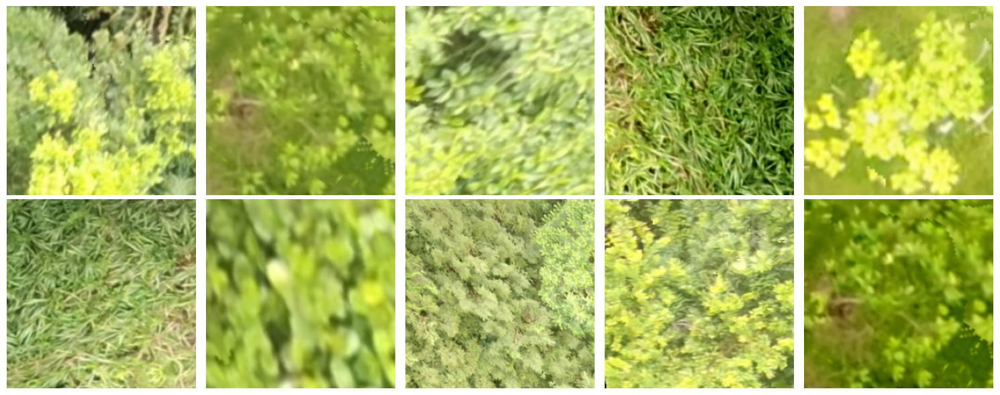

In [252]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=20),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)

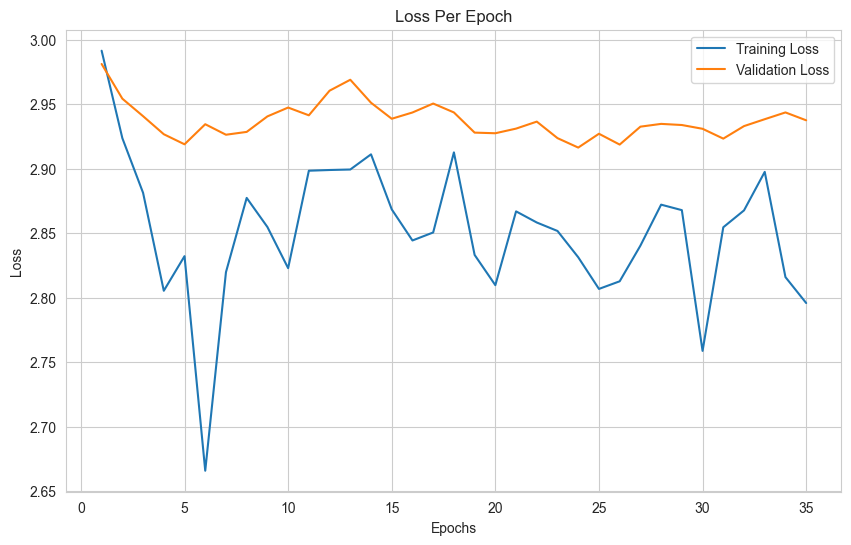

In [253]:
trainer.plot_loss()

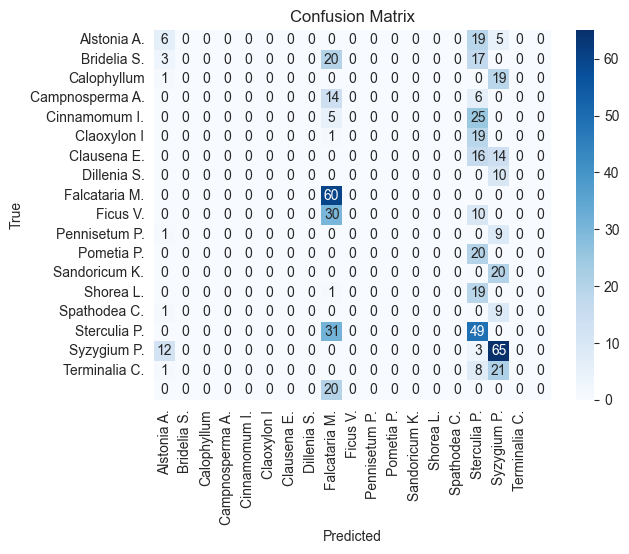

Classification Accuracy: 30.51%


In [254]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia S.", "Calophyllum", "Campnosperma A.", "Cinnamomum I.", "Claoxylon I", "Clausena E.", "Dillenia S.", "Falcataria M.", "Ficus V.", "Pennisetum P.", "Pometia P.", "Sandoricum K.", "Shorea L.", "Spathodea C.", "Sterculia P.", "Syzygium P.", "Terminalia C."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix: Random Sampling")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

# Testing with Weight Decay

10<sup>-2</sup>

Evaluating: 100%|██████████| 37/37 [00:26<00:00,  1.39it/s]


Early stopping triggered


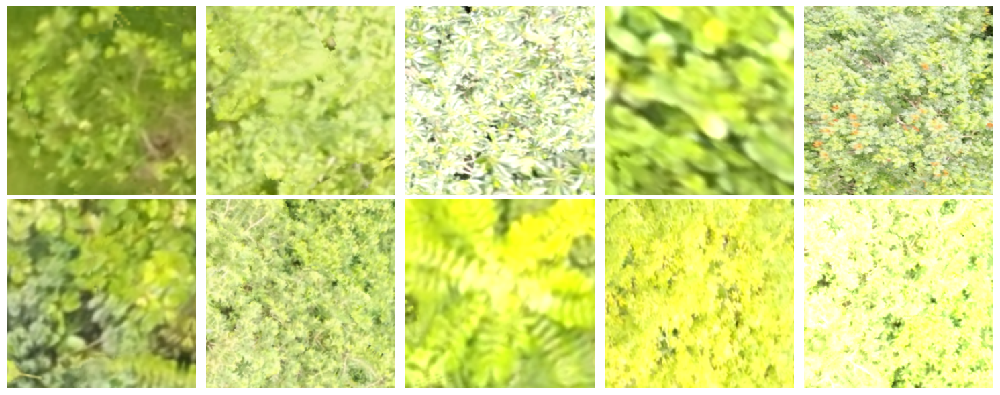

In [105]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=19),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=1e-2)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)

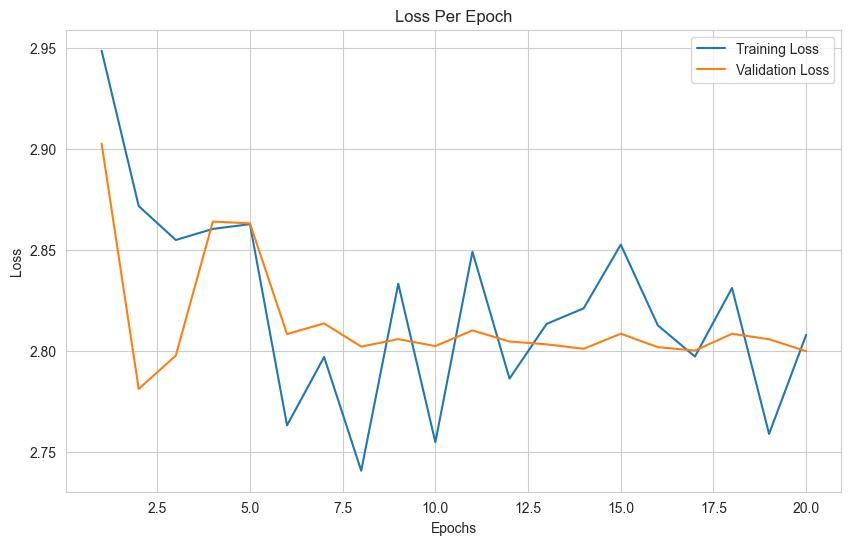

In [106]:
trainer.plot_loss()

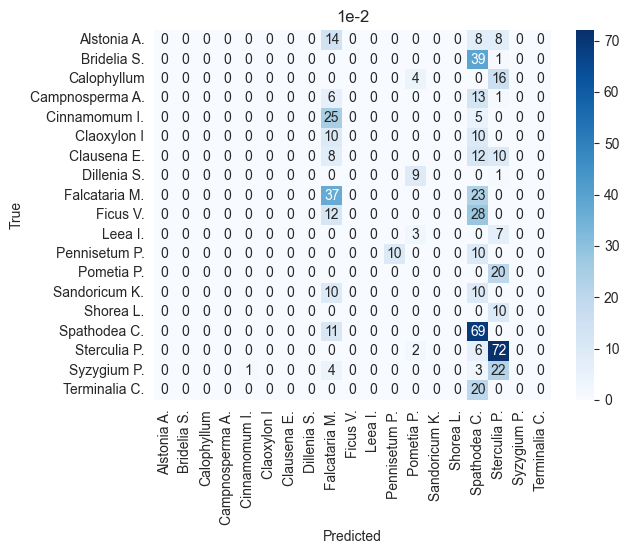

Classification Accuracy: 31.86%


In [107]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia S.", "Calophyllum", "Campnosperma A.", "Cinnamomum I.", "Claoxylon I", "Clausena E.", "Dillenia S.", "Falcataria M.", "Ficus V.", "Leea I.", "Pennisetum P.", "Pometia P.", "Sandoricum K.", "Shorea L.", "Spathodea C.", "Sterculia P.", "Syzygium P.", "Terminalia C."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("1e-2")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

10<sup>-3</sup>

Evaluating: 100%|██████████| 37/37 [00:24<00:00,  1.50it/s]


Early stopping triggered


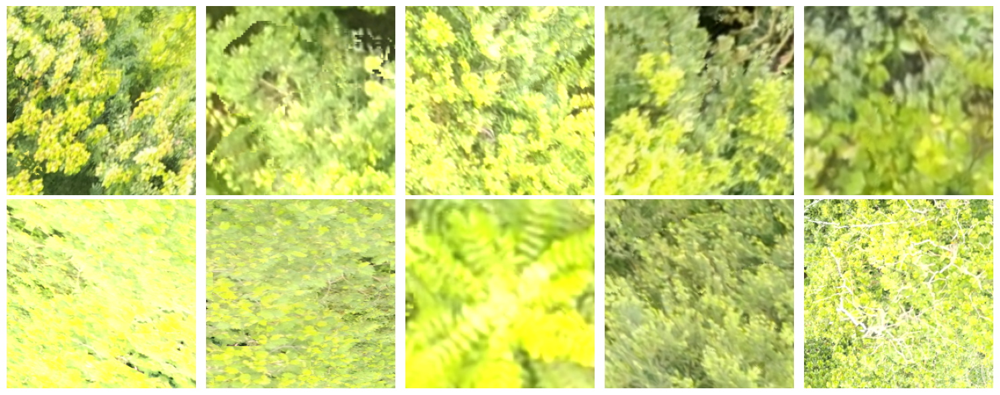

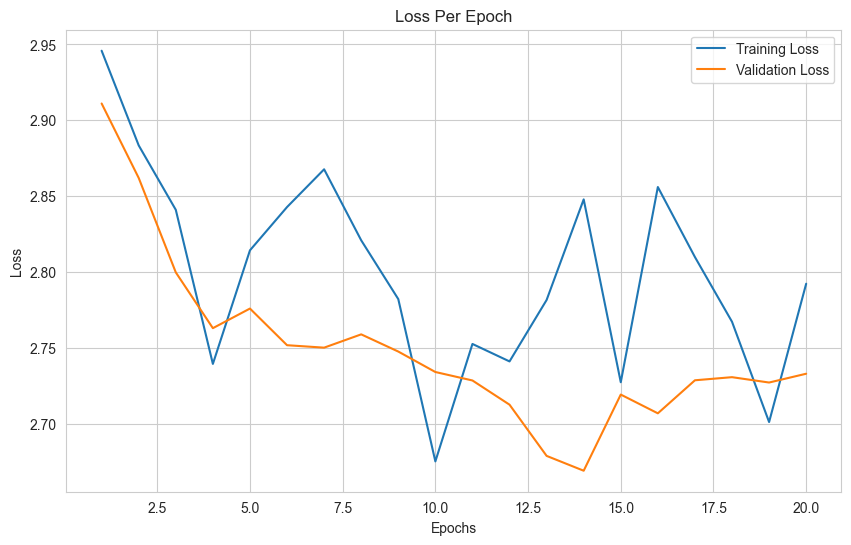

In [77]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=19),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=1e-3)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)
trainer.plot_loss()

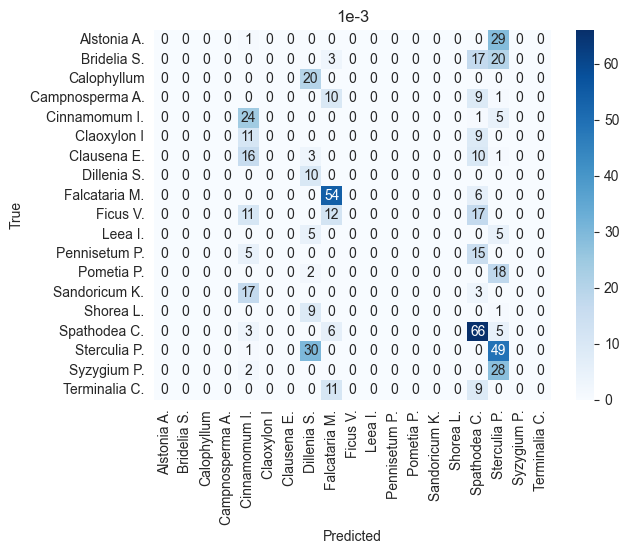

Classification Accuracy: 34.41%


In [79]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia S.", "Calophyllum", "Campnosperma A.", "Cinnamomum I.", "Claoxylon I", "Clausena E.", "Dillenia S.", "Falcataria M.", "Ficus V.", "Leea I.", "Pennisetum P.", "Pometia P.", "Sandoricum K.", "Shorea L.", "Spathodea C.", "Sterculia P.", "Syzygium P.", "Terminalia C."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("1e-3")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

10<sup>-4</sup>

Evaluating: 100%|██████████| 37/37 [00:25<00:00,  1.42it/s]


Early stopping triggered


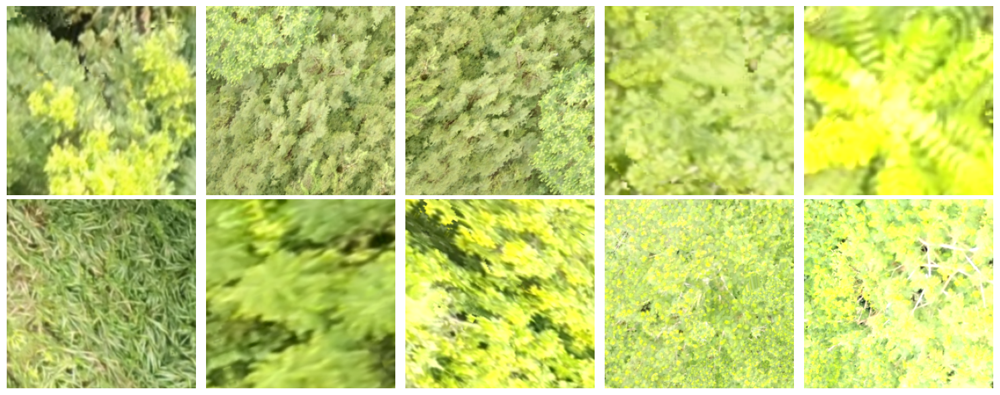

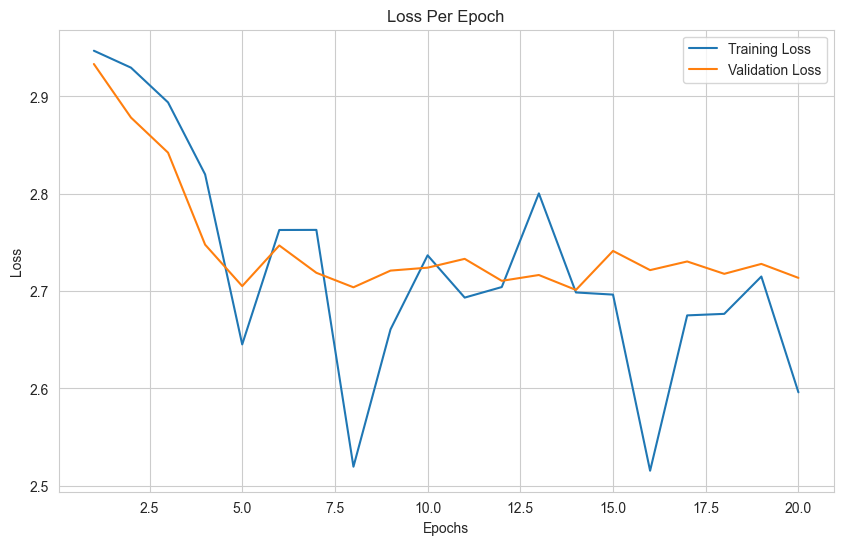

In [83]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=19),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=1e-4)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)
trainer.plot_loss()

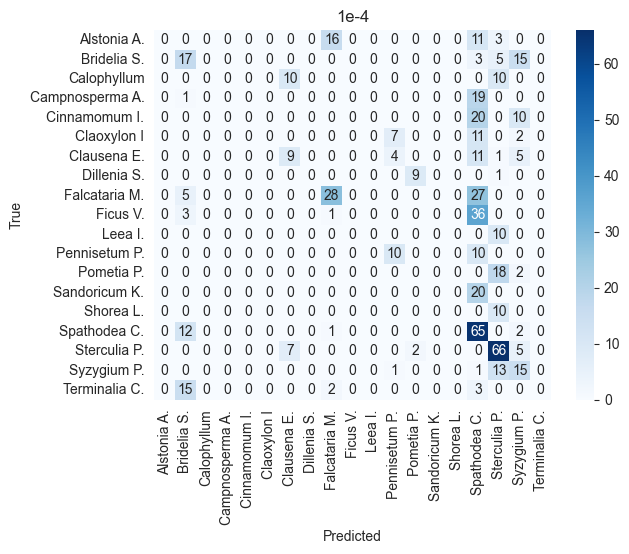

Classification Accuracy: 35.59%


In [84]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia S.", "Calophyllum", "Campnosperma A.", "Cinnamomum I.", "Claoxylon I", "Clausena E.", "Dillenia S.", "Falcataria M.", "Ficus V.", "Leea I.", "Pennisetum P.", "Pometia P.", "Sandoricum K.", "Shorea L.", "Spathodea C.", "Sterculia P.", "Syzygium P.", "Terminalia C."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("1e-4")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

10<sup>-5</sup>

Evaluating: 100%|██████████| 37/37 [00:26<00:00,  1.38it/s]


Early stopping triggered


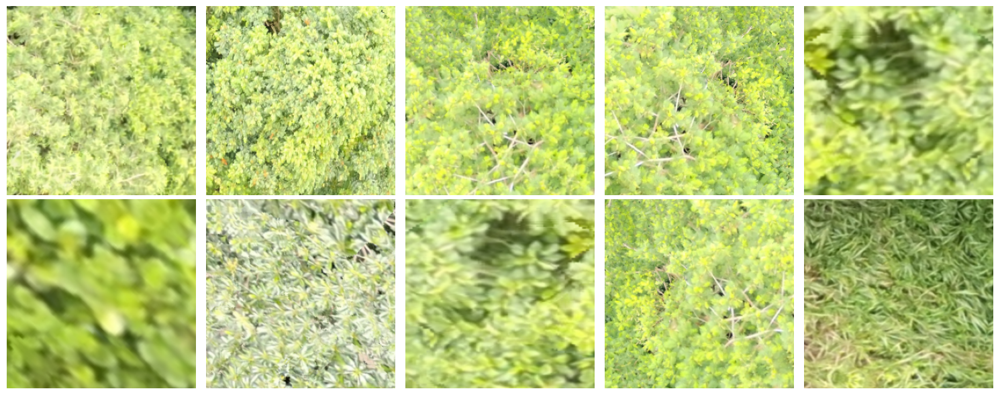

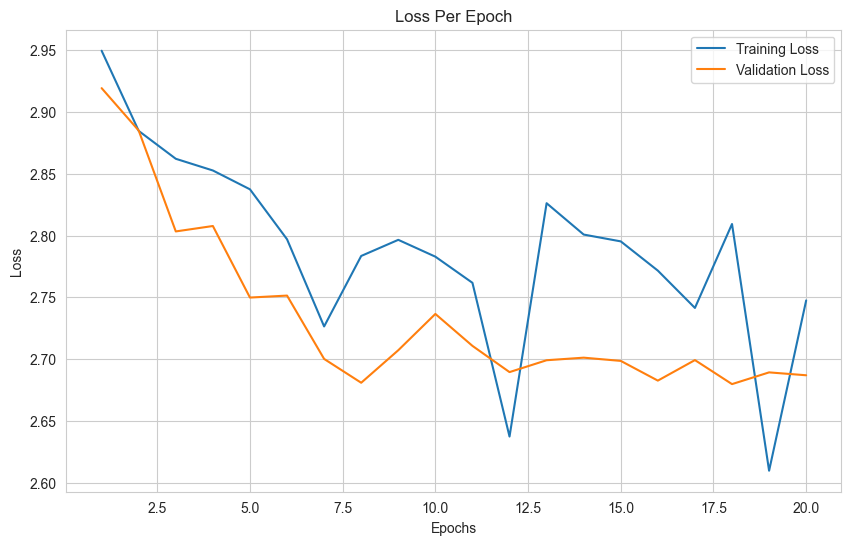

In [89]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=19),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=1e-5)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)
trainer.plot_loss()

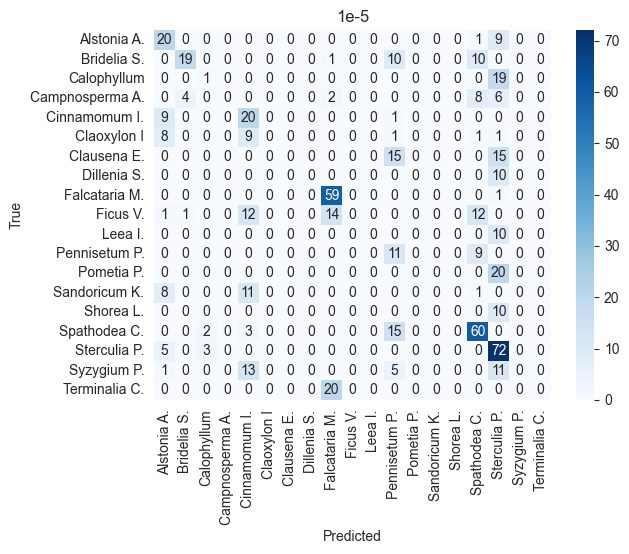

Classification Accuracy: 44.41%


In [90]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia S.", "Calophyllum", "Campnosperma A.", "Cinnamomum I.", "Claoxylon I", "Clausena E.", "Dillenia S.", "Falcataria M.", "Ficus V.", "Leea I.", "Pennisetum P.", "Pometia P.", "Sandoricum K.", "Shorea L.", "Spathodea C.", "Sterculia P.", "Syzygium P.", "Terminalia C."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("1e-5")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

10<sup>-6</sup>

Evaluating: 100%|██████████| 37/37 [00:26<00:00,  1.39it/s]


Early stopping triggered


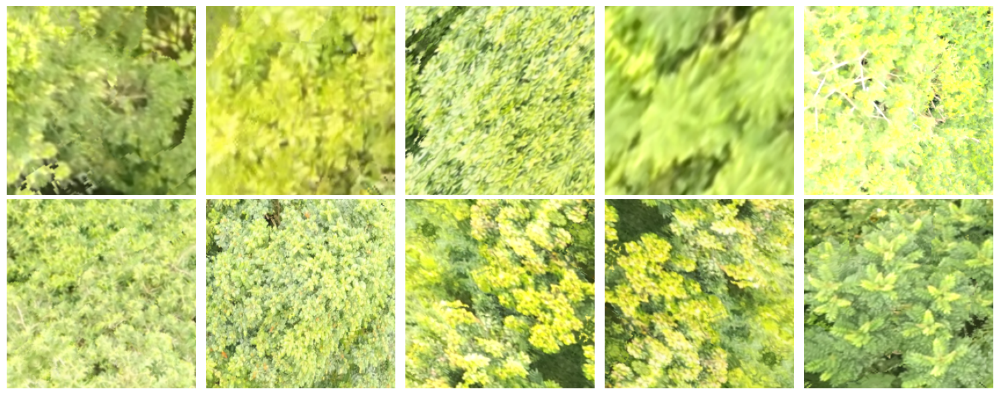

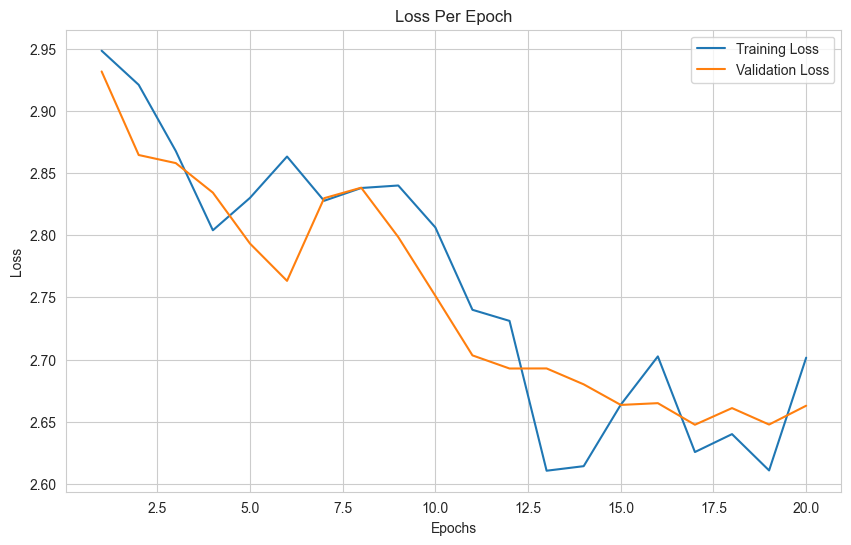

In [95]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=19),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=1e-6)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)
trainer.plot_loss()

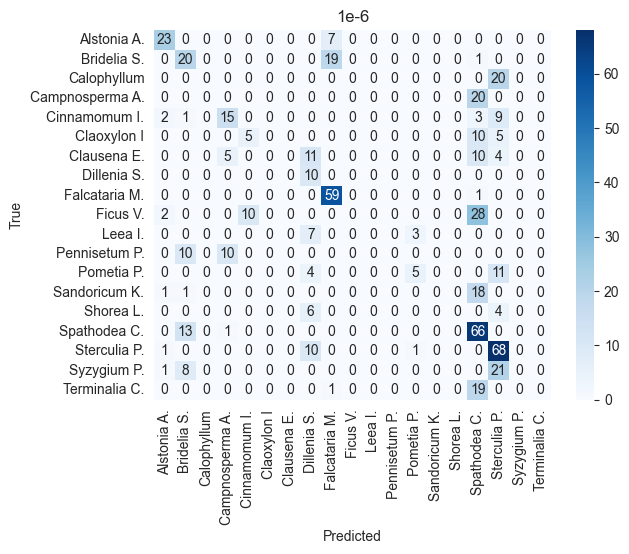

Classification Accuracy: 42.54%


In [96]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia S.", "Calophyllum", "Campnosperma A.", "Cinnamomum I.", "Claoxylon I", "Clausena E.", "Dillenia S.", "Falcataria M.", "Ficus V.", "Leea I.", "Pennisetum P.", "Pometia P.", "Sandoricum K.", "Shorea L.", "Spathodea C.", "Sterculia P.", "Syzygium P.", "Terminalia C."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("1e-6")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

10<sup>-7</sup>

Evaluating: 100%|██████████| 37/37 [00:26<00:00,  1.37it/s]


Early stopping triggered


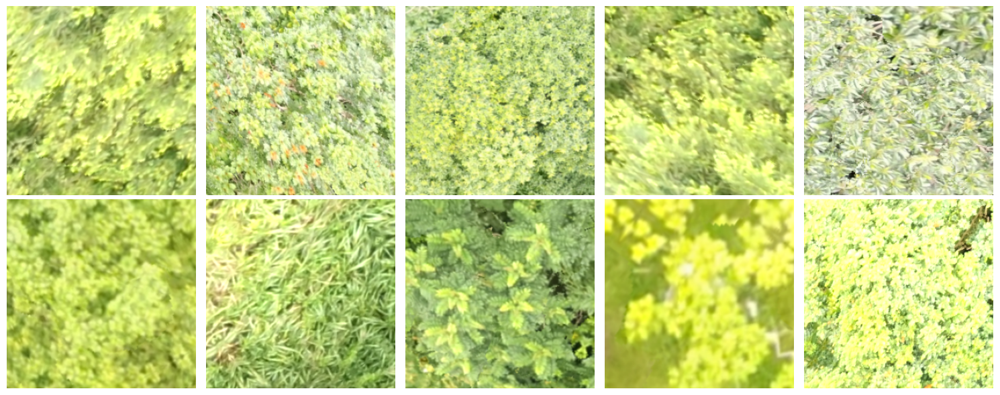

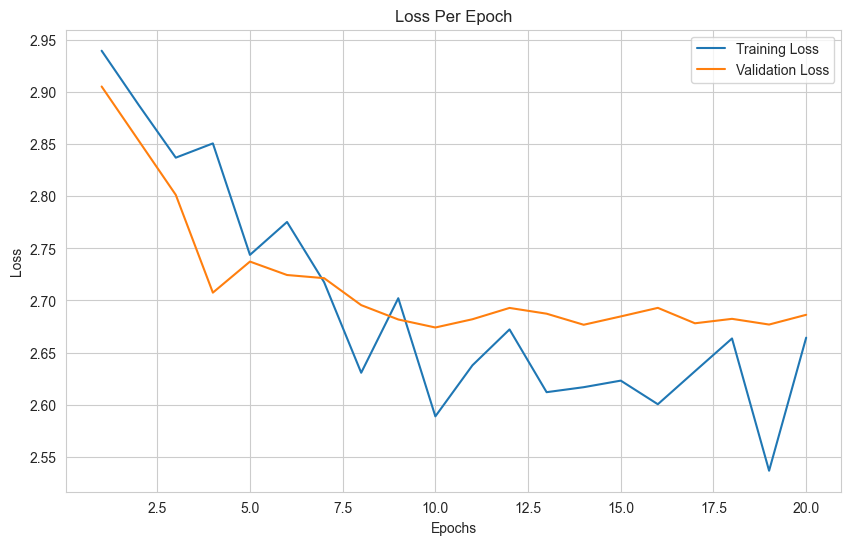

In [100]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=19),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=1e-7)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)
trainer.plot_loss()

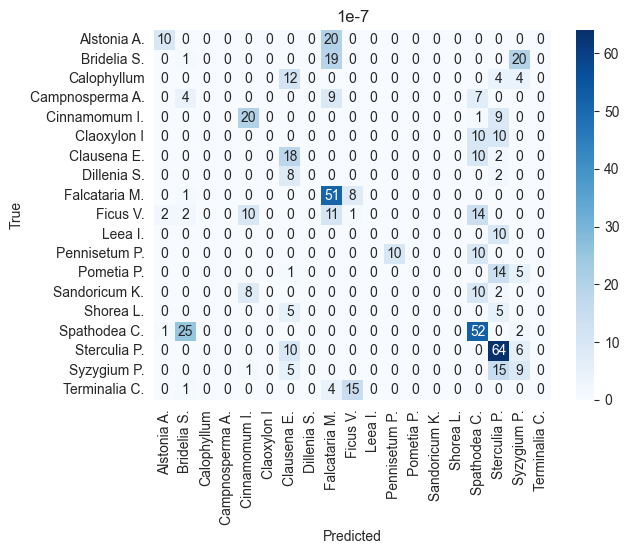

Classification Accuracy: 40.00%


In [101]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia S.", "Calophyllum", "Campnosperma A.", "Cinnamomum I.", "Claoxylon I", "Clausena E.", "Dillenia S.", "Falcataria M.", "Ficus V.", "Leea I.", "Pennisetum P.", "Pometia P.", "Sandoricum K.", "Shorea L.", "Spathodea C.", "Sterculia P.", "Syzygium P.", "Terminalia C."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("1e-7")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

# Testing on Number of Classes

## 5 Classes

Evaluating: 100%|██████████| 14/14 [00:09<00:00,  1.45it/s]


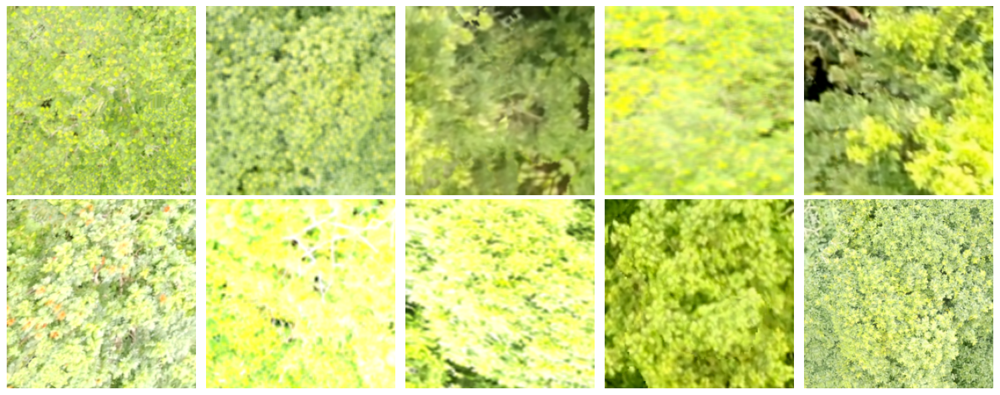

In [395]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=30)

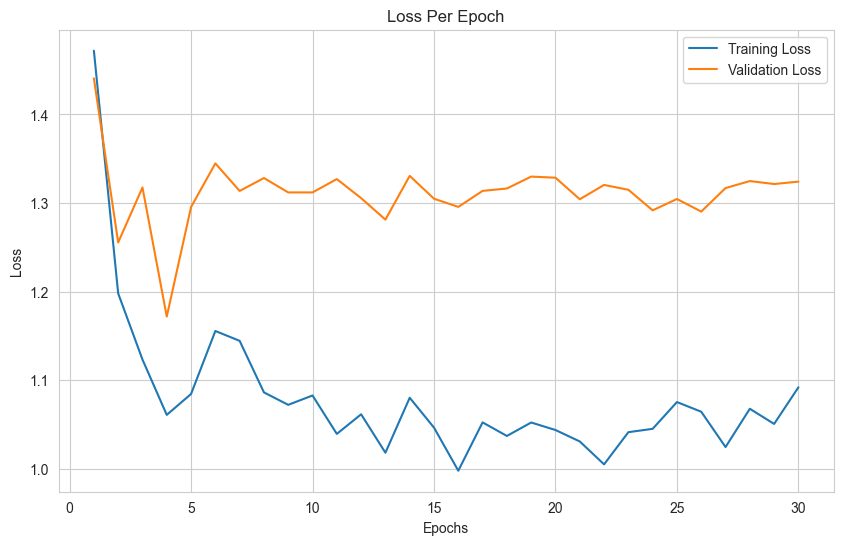

In [396]:
trainer.plot_loss()

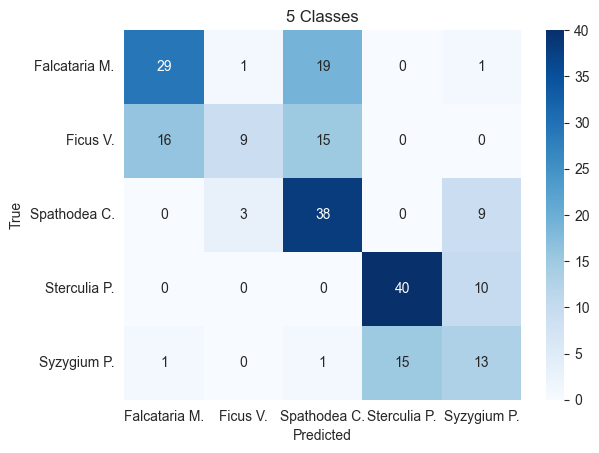

Classification Accuracy: 58.64%


In [398]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Falcataria M.", "Ficus V.", "Spathodea C.", "Sterculia P.", "Syzygium P."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("5 Classes")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

Evaluating: 100%|██████████| 15/15 [00:10<00:00,  1.43it/s]


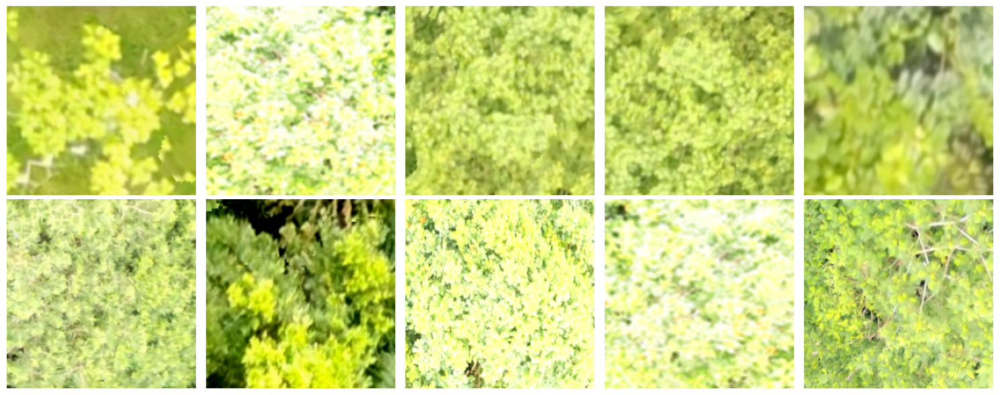

In [407]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=6),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=30)

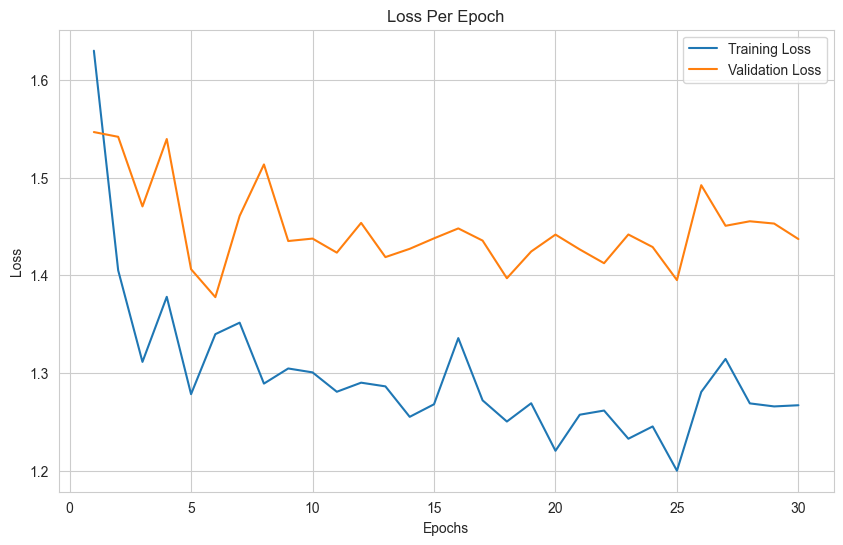

In [408]:
trainer.plot_loss()

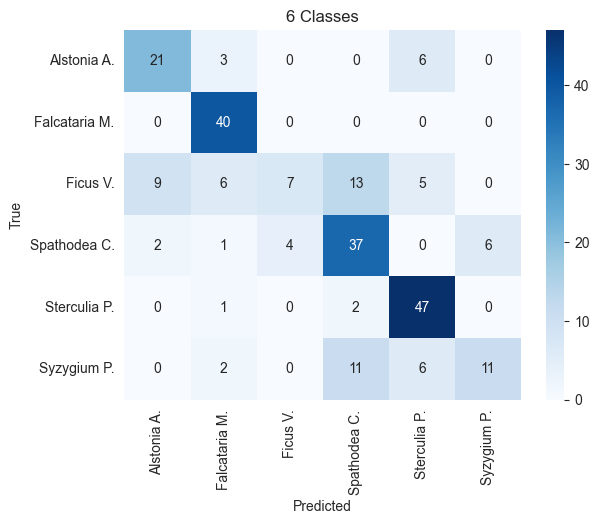

Classification Accuracy: 67.92%


In [409]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Falcataria M.", "Ficus V.", "Spathodea C.", "Sterculia P.", "Syzygium P."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("6 Classes")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

Evaluating: 100%|██████████| 18/18 [00:12<00:00,  1.41it/s]


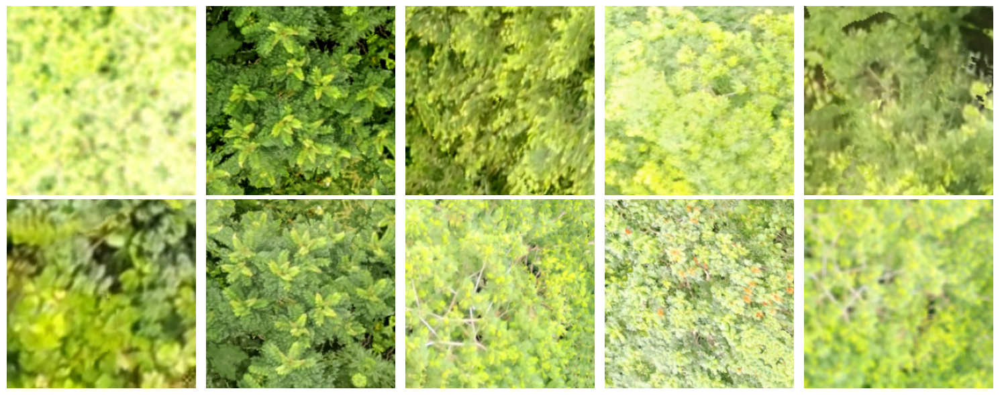

In [417]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=7),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=30)

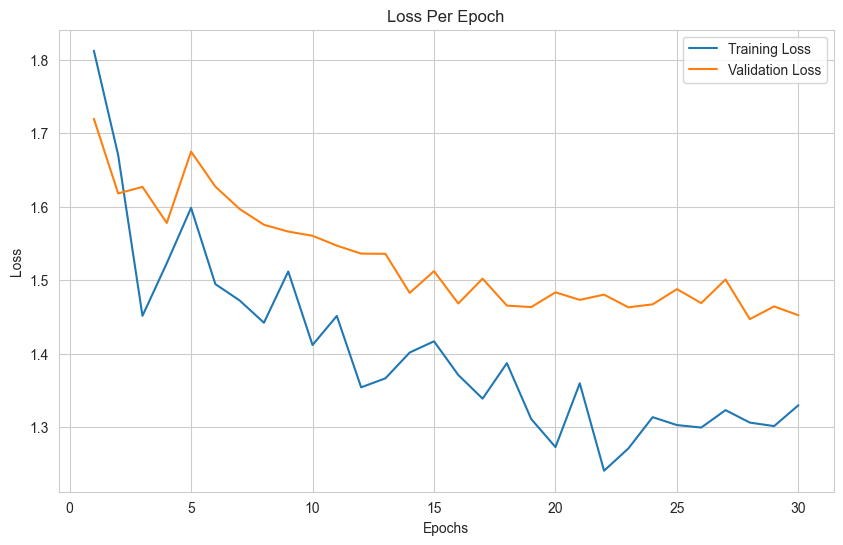

In [418]:
trainer.plot_loss()

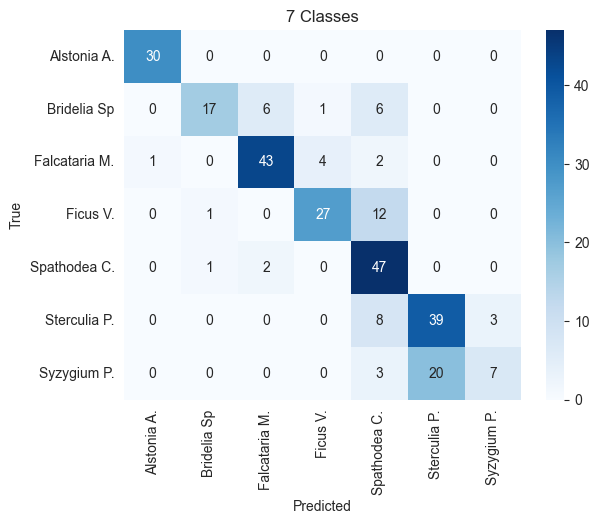

Classification Accuracy: 75.00%


In [420]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia Sp", "Falcataria M.", "Ficus V.", "Spathodea C.", "Sterculia P.", "Syzygium P."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("7 Classes")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

Evaluating: 100%|██████████| 20/20 [00:14<00:00,  1.41it/s]


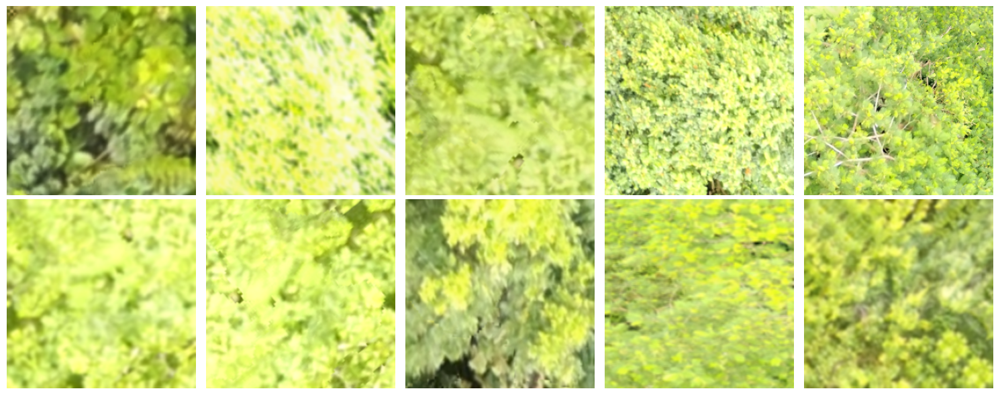

In [435]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=8),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=30)

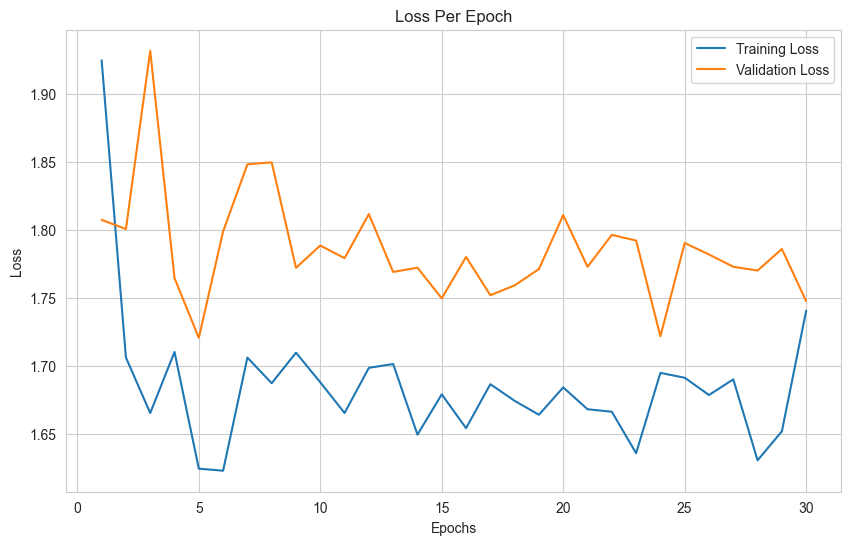

In [436]:
trainer.plot_loss()

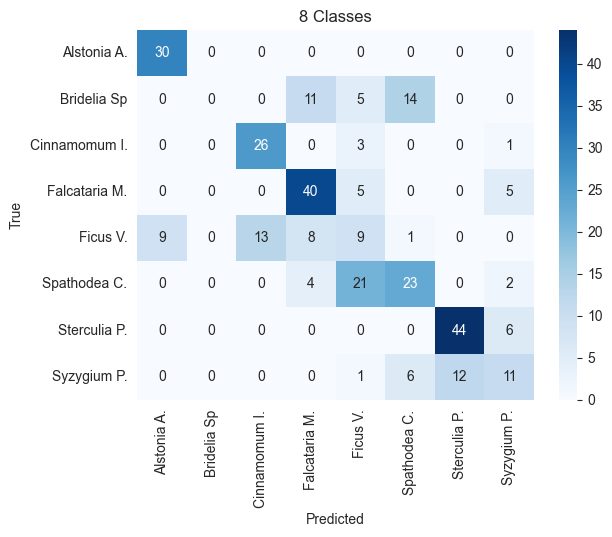

Classification Accuracy: 59.03%


In [437]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia Sp", "Cinnamomum I.", "Falcataria M.", "Ficus V.", "Spathodea C.", "Sterculia P.", "Syzygium P."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("8 Classes")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

Evaluating: 100%|██████████| 22/22 [00:20<00:00,  1.06it/s]


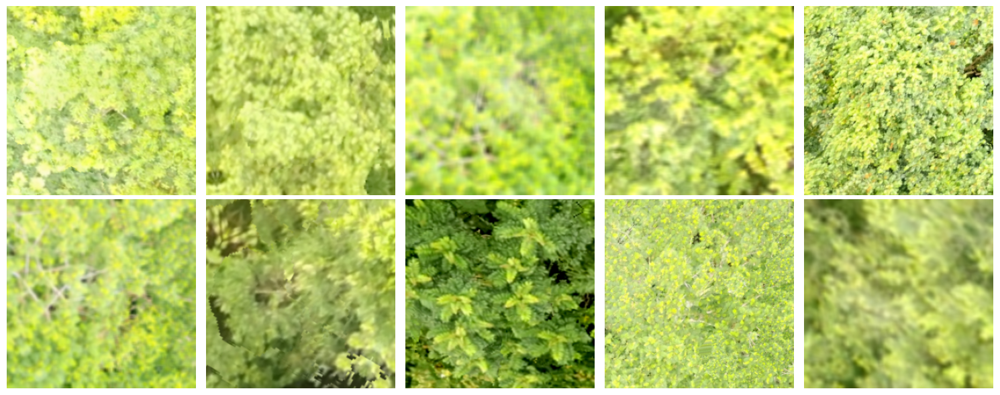

In [446]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=9),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=35)

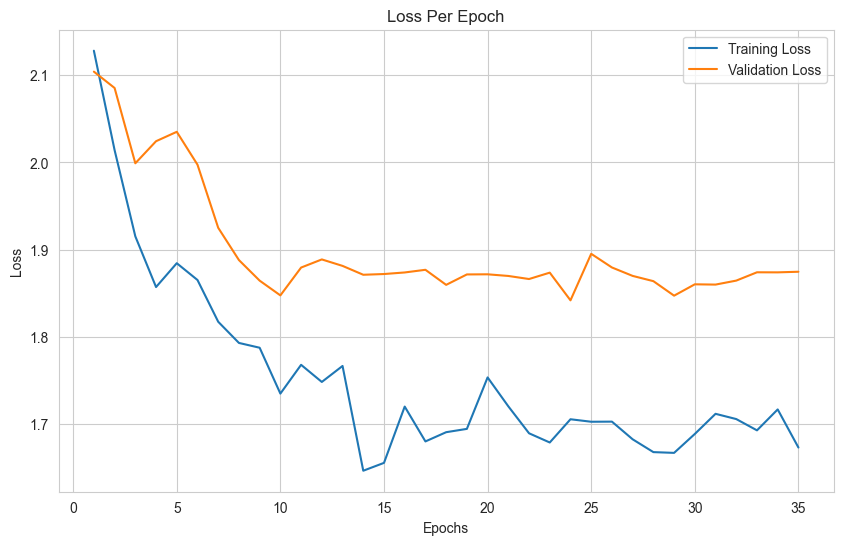

In [447]:
trainer.plot_loss()

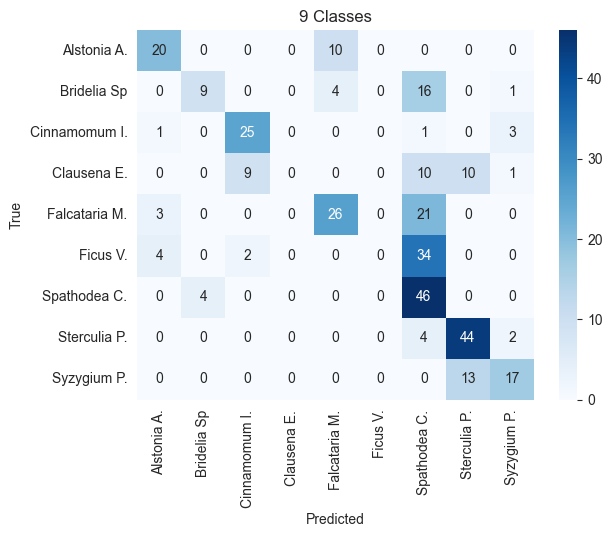

Classification Accuracy: 55.00%


In [448]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia Sp", "Cinnamomum I.", "Clausena E.", "Falcataria M.", "Ficus V.", "Spathodea C.", "Sterculia P.", "Syzygium P."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("9 Classes")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))

Evaluating: 100%|██████████| 23/23 [00:15<00:00,  1.45it/s]


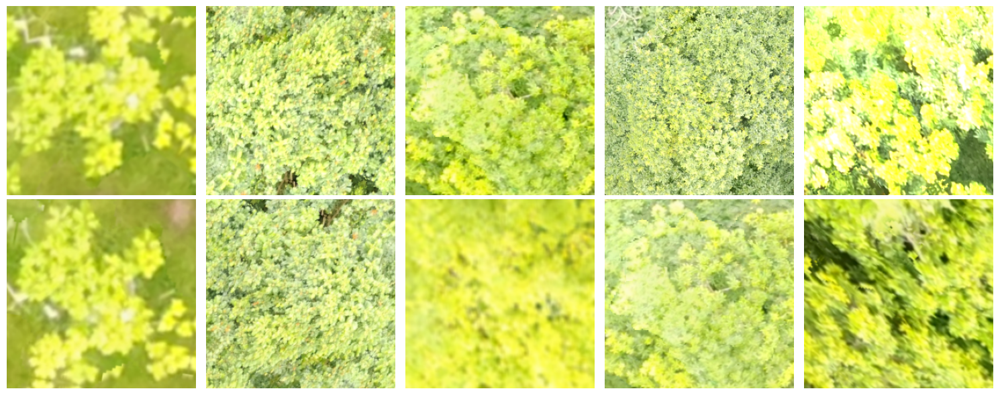

In [458]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=10),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=35)

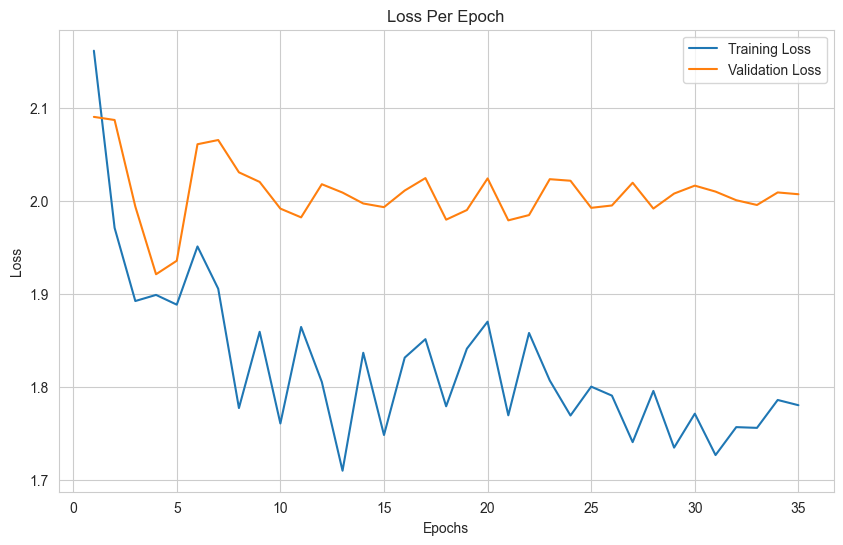

In [459]:
trainer.plot_loss()

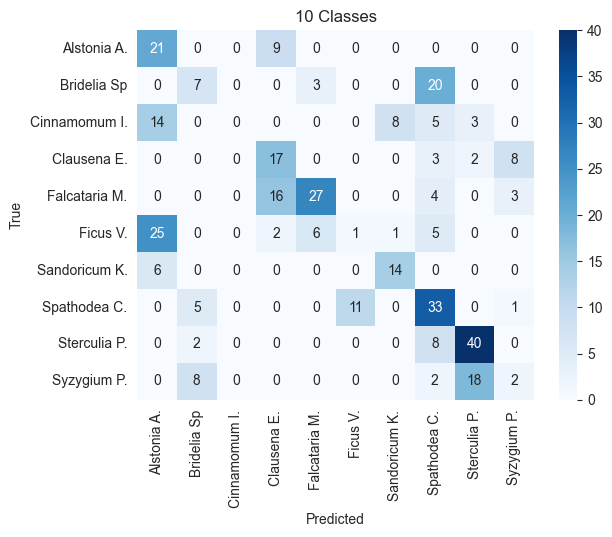

Classification Accuracy: 45.00%


In [460]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Alstonia A.", "Bridelia Sp", "Cinnamomum I.", "Clausena E.", "Falcataria M.", "Ficus V.", "Sandoricum K.", "Spathodea C.", "Sterculia P.", "Syzygium P."]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("10 Classes")
plt.show()

accuracy_full = accuracy
print("Classification Accuracy: {:.2%}".format(accuracy))